# Exploratory Data Analysis
In this notebook I explore the data, gaining as many meaningful insights I can along the way. This is a crucial step in preperation for machine learning. I will be looking at the variable's distributions more in-depth and I'll be looking to see if any of the variables have relationships with one another (e.g. when one goes up one goes down), and/or with the target target variable (e.g. if one is up and the other is in the middle, then it's likely to be fraud). Along the way I may find specific questions I want to answer. One question I already want to know the answer to is "Does the amount of the transaction reliably indicate some probability of it being a fraud?". These questions will be answered through statistical tests. Take note that I will only be using the training set to avoid biasing myself and to ensure the test set is "unseen" as possible.

### Road Map
1) Univariate Analysis (Distributions) <br>
2) Bi-variate Analysis (Two-way Relationships) <br>
3) Tri-variate Analysis (Two-way Relationships and Class) <br>
4) Questions (Statistical Tests)

As always, I will start with importing libraries and loading the data.

In [19]:
# import libraries

# standard scientific libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# illustrations
import seaborn as sns

# statistical tests
from scipy.stats import levene, ttest_ind

# machine learning metrics
from sklearn.metrics import f1_score, precision_score, recall_score

In [4]:
# load data
# NOTE: only use training set
train = pd.read_csv("train.csv")

# print head to ensure proper loading
train.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,2.238954,-1.724499,-2.151484,-2.577803,0.993668,3.565492,-1.785957,0.860122,-1.264003,1.567867,...,-0.149574,-0.049333,0.278442,0.684735,-0.219028,-0.159167,0.037920,-0.049932,3.466048,0
1,-1.315062,1.630783,0.597001,-0.038359,-0.404580,-0.965712,0.212249,0.735381,-1.267926,-0.482635,...,-0.238898,-0.946773,0.323904,0.515632,-0.713000,-0.266503,-0.017794,0.051058,1.945910,0
2,1.908801,0.021184,-2.087997,0.129310,1.161468,0.605244,-0.022371,0.180296,0.283819,-0.497766,...,0.293609,1.095842,-0.044874,-1.689517,0.106098,0.007758,0.045164,-0.053068,2.705380,0
3,1.811257,0.316556,0.316751,3.880231,0.048454,1.020163,-0.734868,0.233651,0.681423,1.146705,...,0.138869,0.700422,0.174064,0.702997,-0.212523,-0.010018,-0.017740,-0.038006,2.851284,0
4,1.358817,-1.120881,0.550266,-1.547659,-1.194950,0.275448,-1.201843,0.212889,-2.094285,1.492821,...,-0.340972,-0.636442,0.252758,-0.344160,-0.064282,-0.439622,0.062524,0.013095,3.178470,0


# 1. Univariate Analysis

Now I am going to take a closer look at the distributions of the variables. I will do this with kernel density estimation plots. A "KDE" is like a histogram, except instead of graphing how many data points lie in certain ranges, a KDE calculates the probability of picking any datapoint and it happening to lie in that range. It is a smooth continuos line. You can select any section of that line, calculate the area under that line, and that area will be the probability that the first data point is in that range on the X-axis.

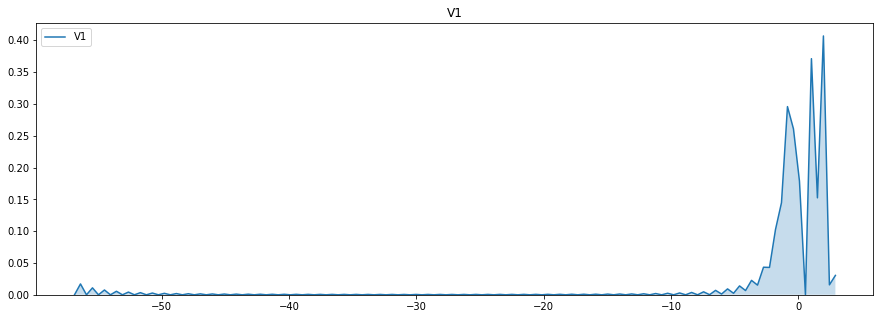

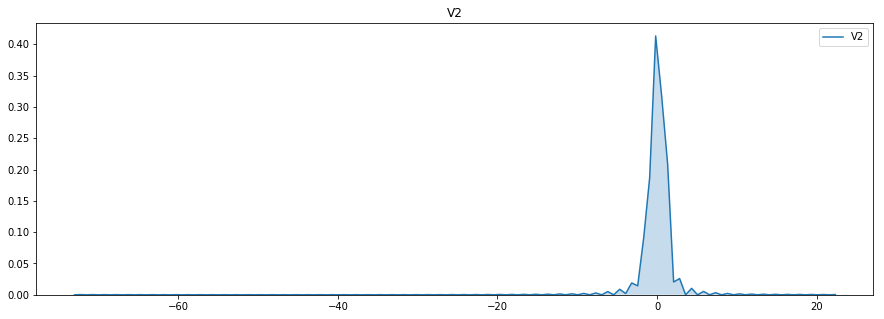

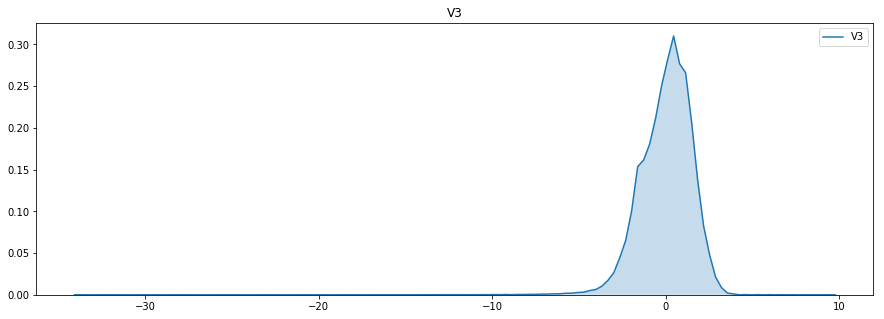

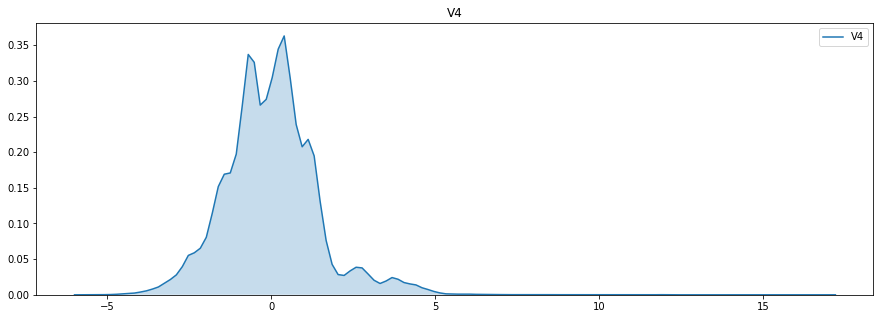

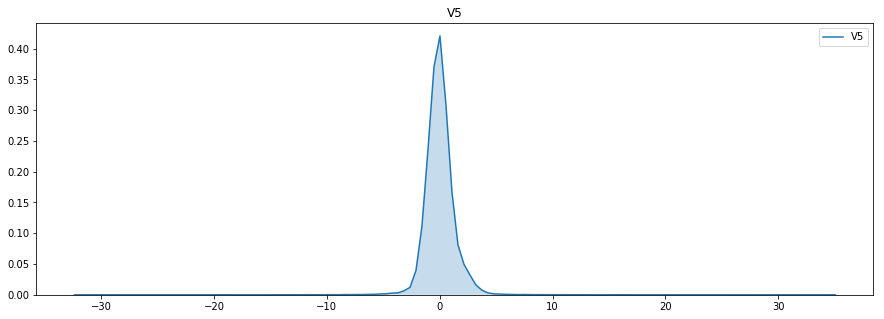

...

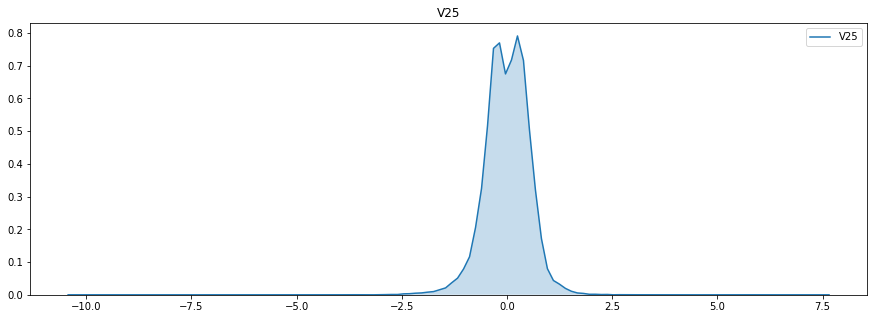

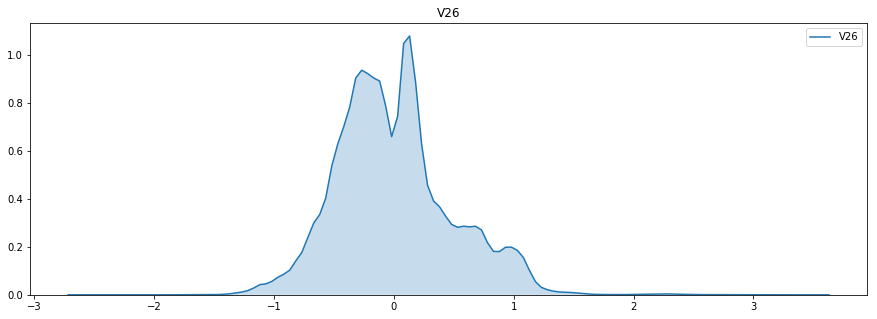

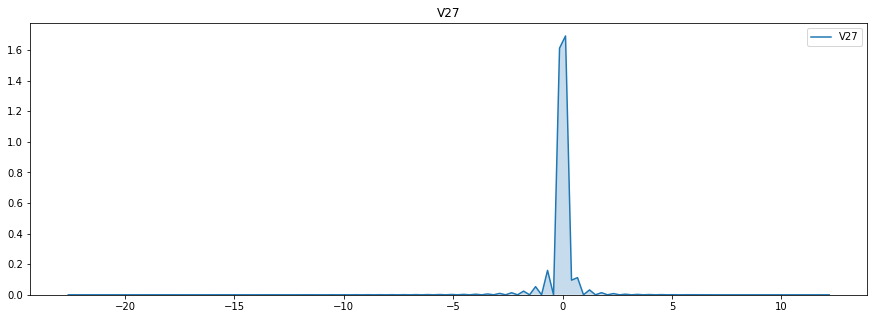

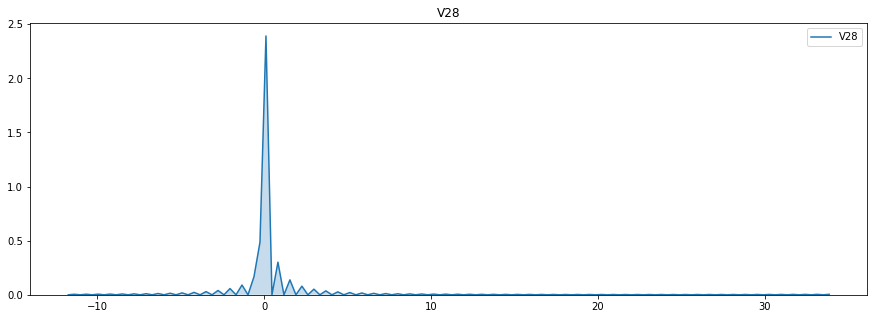

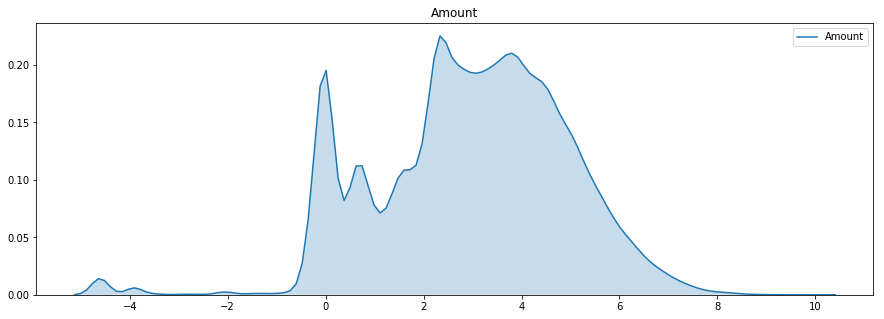

In [5]:
# plot distribution for each variable using
# Kernel Density Estimation plots

# iterate over columns
for col in train.columns:
    
    # make sure it isn't the class column
    if col != "Class":
        
        # plot the distribution
        plt.figure(figsize=(15, 5))
        sns.kdeplot(train[col], shade=True)
        plt.title(col)
        plt.show()

Most of the variables seem to be normally distributed, but they are extremely lepto-kertic and have outliers. V21 and V28 seem to be particularly lepto-kertic. None of the columns are strongly skewed. I will now down-sample the non-fraud class to get a better view of the data.

In [9]:
# down-sample non-fraud class
fraud = train[train["Class"] == 1]
nonfraud = train[train["Class"] == 0].sample(frac=0.002)
balanced_df = pd.concat([fraud, nonfraud], axis=0)

# check value counts
balanced_df.Class.value_counts(normalize=True)

0    0.545126
1    0.454874
Name: Class, dtype: float64

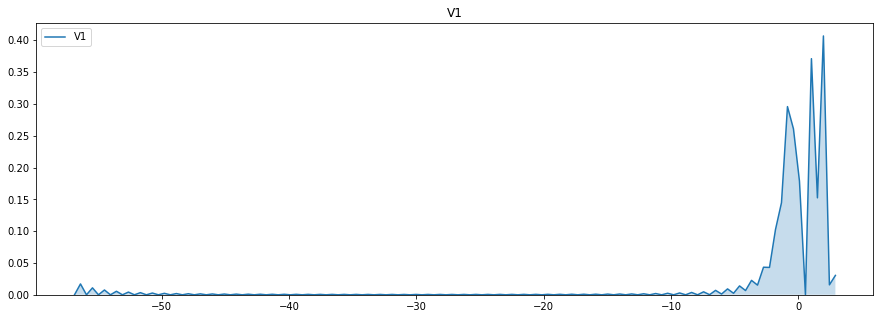

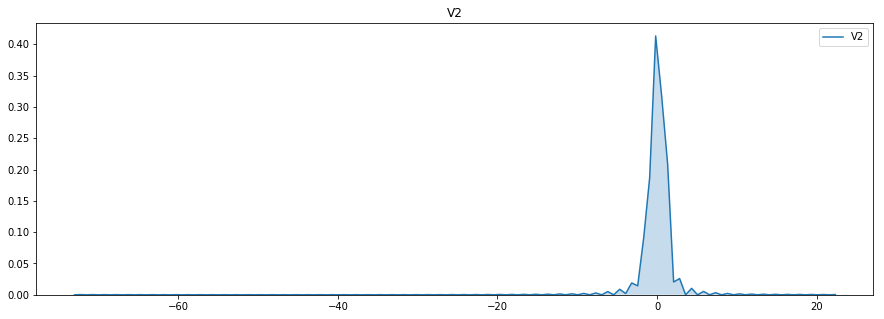

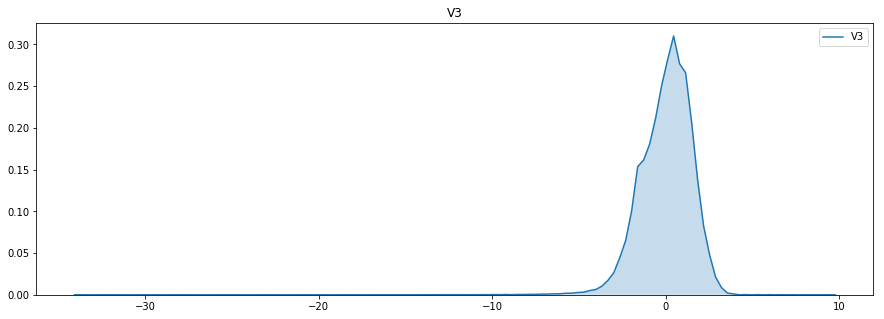

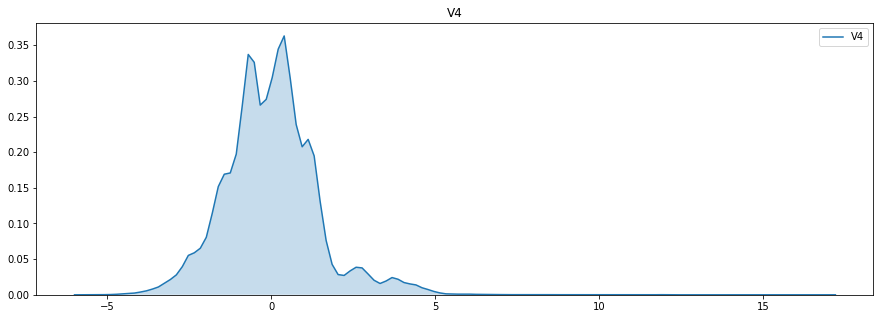

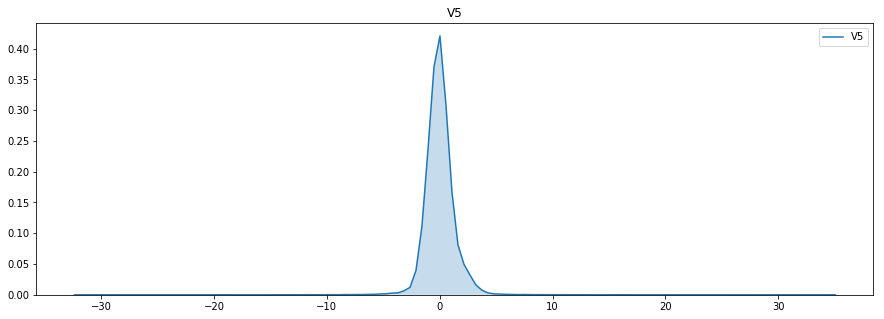

...

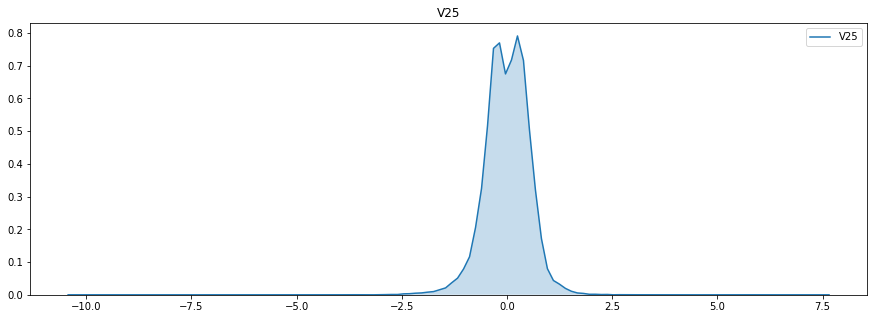

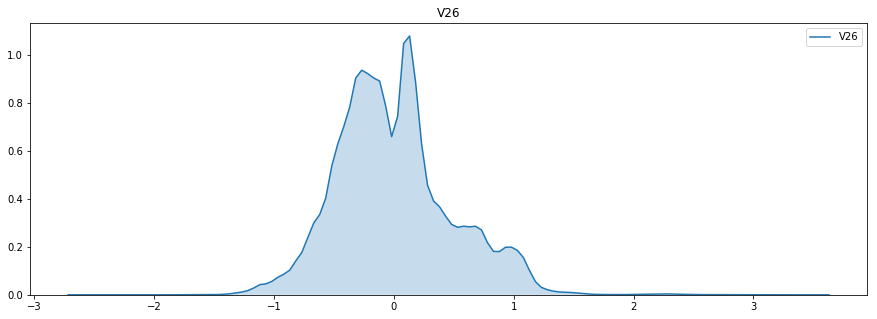

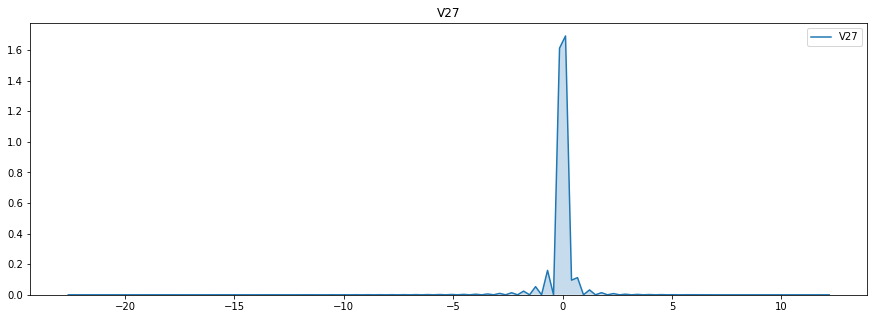

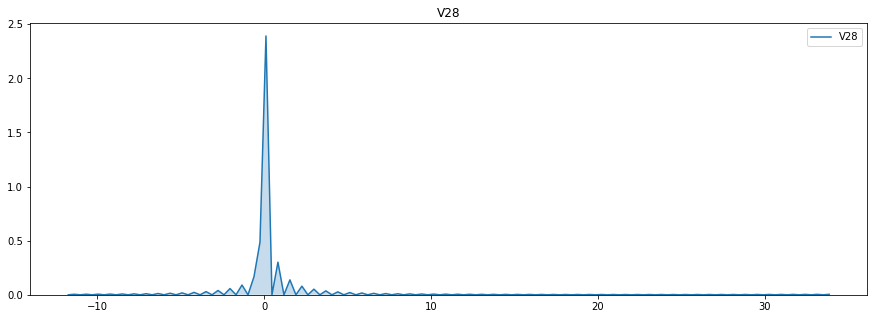

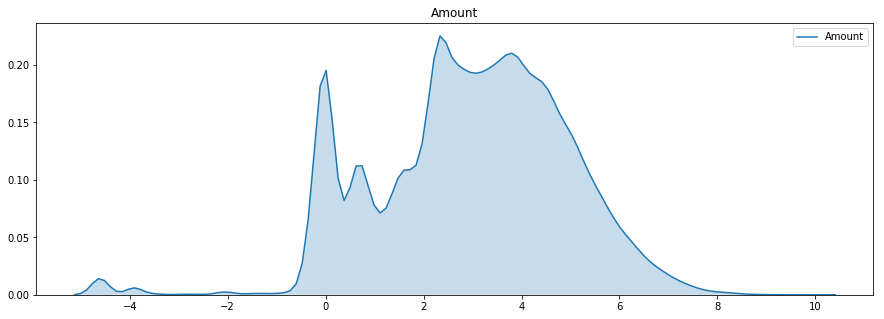

In [10]:
# create kde-plots for each variable using the re-sampled dataframe

# iterate over columns
for col in balanced_df.columns:
    
    # make sure it isn't the class column
    if col != "Class":
        
        # plot the distribution
        plt.figure(figsize=(15, 5))
        sns.kdeplot(train[col], shade=True)
        plt.title(col)
        plt.show()

The results are similar to the unbalanced data.

# 2. Bi-variate Analysis

There are two types of bi-variate analysis I need to do. One will be similar to what I did above, but instead of one line, I will create two lines. One for fraud data points and one for non-fraud data points. This will let me know if any variable has a direct relationship to class and if so, how string that relationship is. After all, what if all we needed to know was that "if this one variable is over this value, then its always a fraud". Once I do that I will make scatter plots for each combination of two variables. The scatter plots will show if one variable reacts to another. If they do that could be bad for machine learning algorithms and also it could lead to key insights.

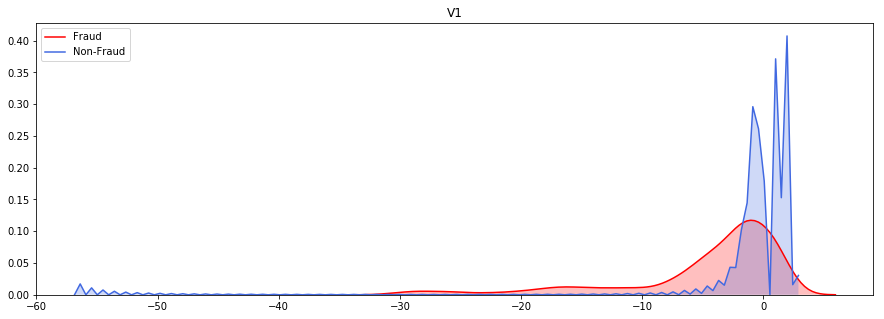

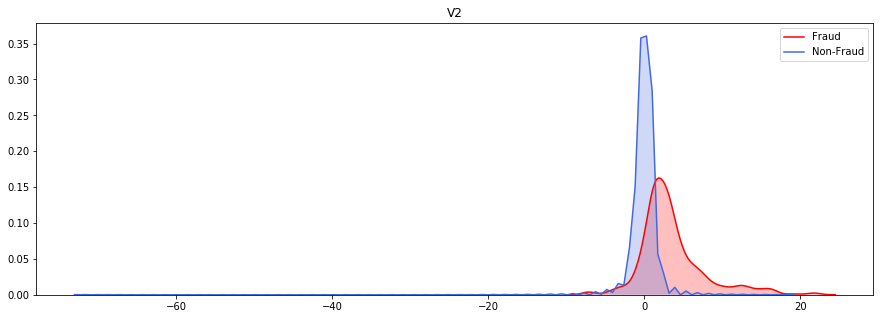

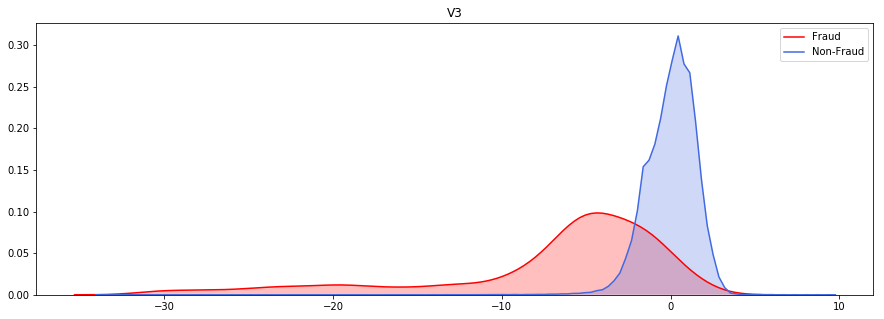

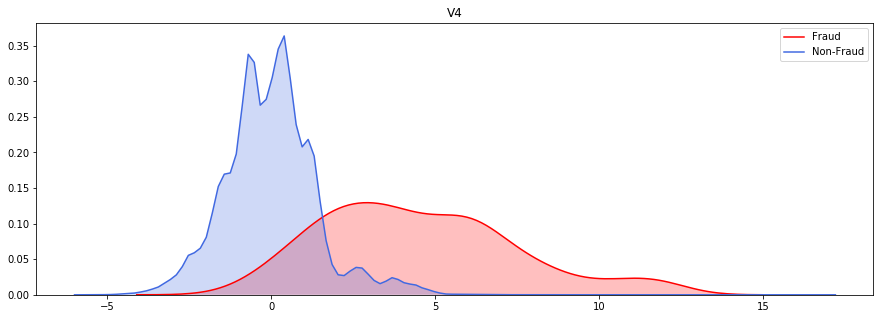

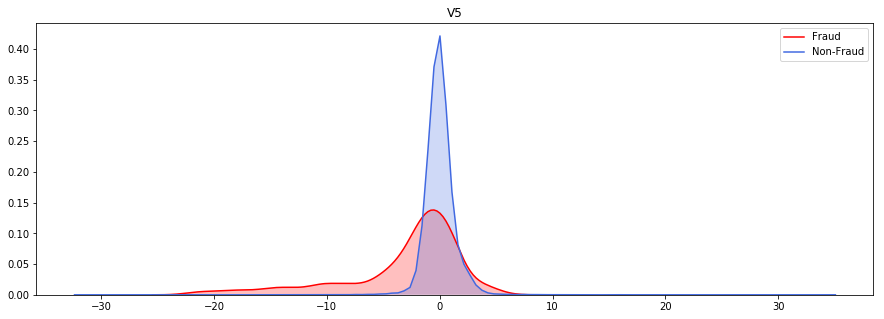

...

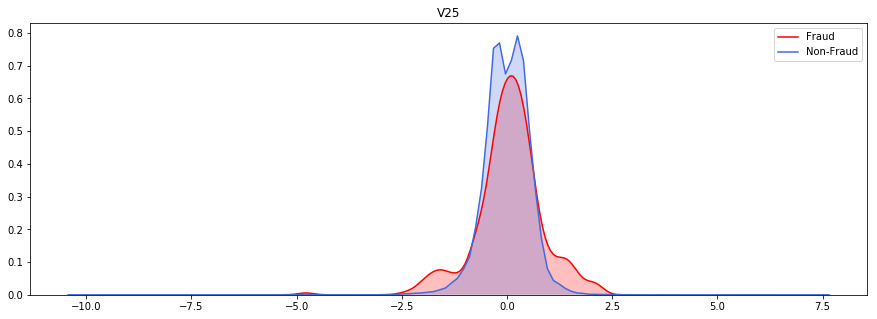

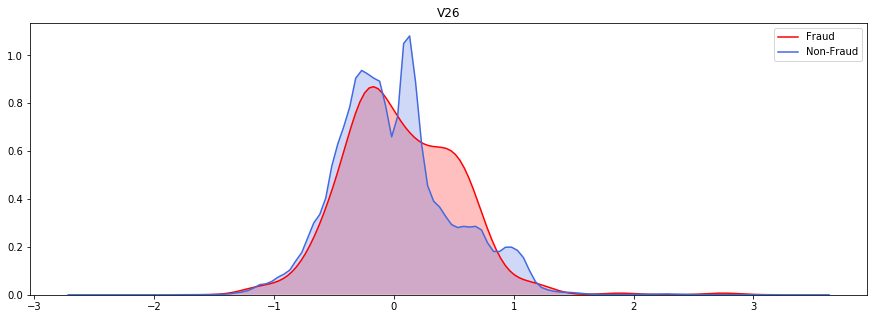

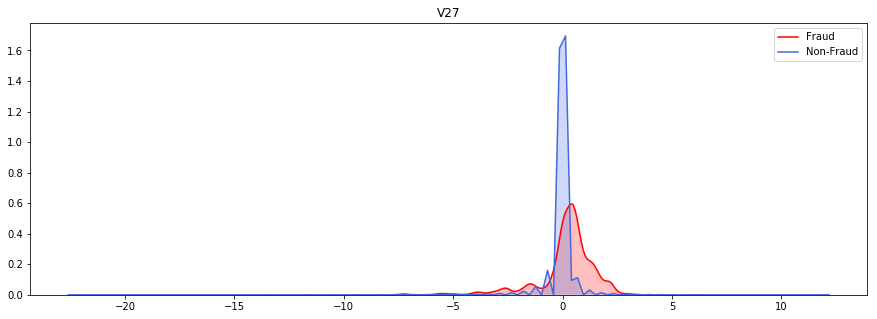

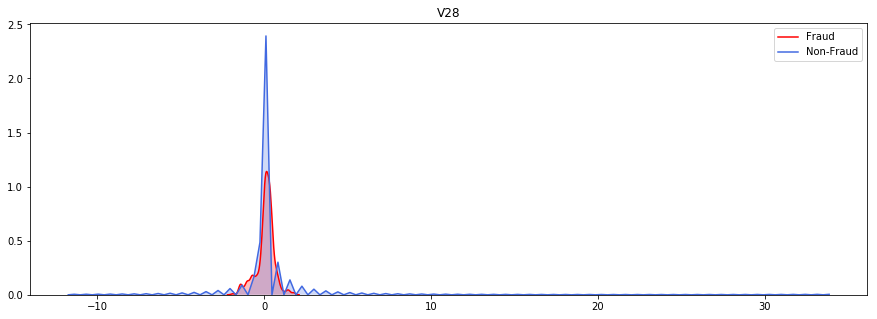

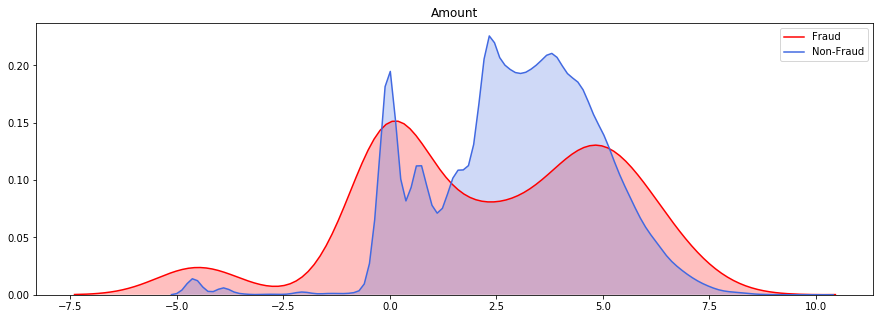

In [18]:
# plot Kernel Density Estimation plots of
# each variable when split by Class

# split train into two dataframes one with 
# only fraud and one with only non-fraud
fraud = train[train.Class == 1]
non_fraud = train[train.Class == 0]

    
# iterate over all columns
for col in train.columns:
        
    # make sure not to include Class column
    if col != "Class":
            
        # plot KDEs for column from both
        # dataframe slices
        plt.figure(figsize=(15, 5))
        sns.kdeplot(fraud[col], shade=True, color="red", label="Fraud")
        sns.kdeplot(non_fraud[col], shade=True, color="royalblue", label="Non-Fraud")
        plt.title(col)
        plt.legend()
        plt.show()


It seems that some of the columns can be used alone as an indicator of fraud. Now I will create some "dummy" classifiers to see exactly how good each column is at doing this. I will simply choose a threshold for predicting fraud and non-fraud by trying a 200 thresholds and then I will see which threshold gives the best f1-score. The f1-score is the harmonic mean of precision and recall. It increases when both are high and dramatically decreases when either are low.

In [25]:
# create dummy classifier
class dummy_classifier():
    
    def __init__(self):
        self.thresholds = None
        self.best_score = None
        self.best_threshold = None
        self.direction = None
        
    # method for returning predictions
    # must set best_threshold and direction
    # or call fit method before using
    def predict(self, X):
        
        # depending on the direction, classify each point on whether it is greater then
        # or less then the best threshold
        if self.direction == "less_then":
            return [1 if point < self.best_threshold else 0 for point in X]
        elif self.direction == "greater_then": 
            return [1 if point > self.best_threshold else 0 for point in X]
        else:
            return "error"
        
        
    
    # method for finding best threshold
    def fit(self, X, y):
        
        # create 200 threshold points
        thresholds = np.linspace(X.min(), X.max(), 200)
        
        # record results for each threshold and for each direction
        results_greater_then = []
        results_less_then = []
        
        # test thresholds
        for threshold in thresholds:
            
            # set current threshold to best threshold
            self.best_threshold = threshold
            
            # iterate over both directions to test both
            for current_direction in ["less_then", "greater_then"]:
                
                # set direction
                self.direction = current_direction
            
                # get results for that threshold
                predictions = self.predict(X)
                
                # save f1 score in results
                if current_direction == "less_then":
                    results_less_then.append(f1_score(y, predictions))
                else:
                    results_greater_then.append(f1_score(y, predictions))
            
        # zip results and thresholds and then form a list from the zip
        results_thresholds = list(zip(thresholds, results_less_then, results_greater_then))
        
        # sort list in ascending order
        # based on the highest f1-score for results from either direction
        sorted_results_thresholds = sorted(results_thresholds, reverse=True, key=lambda g: max([g[1], g[2]]))
        
        # find and set the best threshold. It will be the first item of the first item in the sorted list
        self.best_threshold = sorted_results_thresholds[0][0]
        
        # find and set the best direction for than threshold using an if else statement
        if sorted_results_thresholds[0][1] >= sorted_results_thresholds[0][2]:
            self.direction = "less_then"
        
        else:
            self.direction = "greater_then"
        
            

In [26]:
# get results from the dummy classifier for each column

# record results in a dictionary
results = {}

# instantiate classifier
clf = dummy_classifier()

# iterate over each column
for col in train.columns:
    
    # fit classifier
    clf.fit(train[col], train["Class"])
    
    # find and save score of predictions
    predictions = clf.predict(train[col])
    results[col] = f1_score(train["Class"], predictions)
    

ValueError: If using all scalar values, you must pass an index

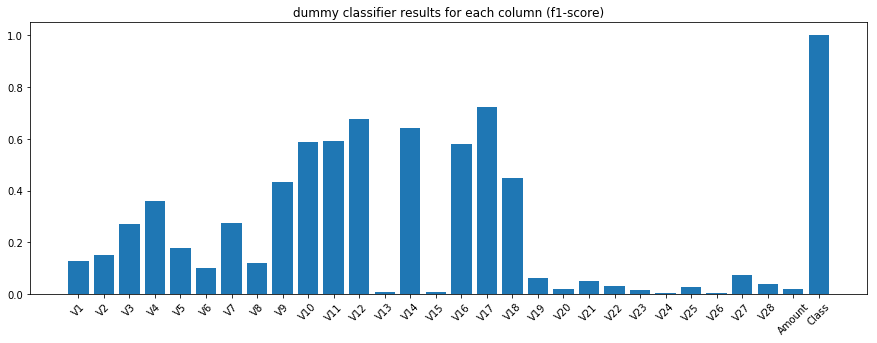

In [32]:
# plot results
results = results.items()

plt.figure(figsize=(15, 5))
plt.bar([x[0] for x in results], [x[1] for x in results])
plt.xticks(rotation=45)
plt.title("dummy classifier results for each column (f1-score)")
plt.show()

We can see here that some columns are approaching an 80% f1-score on the training data just by themselves. To make note, the columns that can achieve a training f1-score above %40 on their own are:
<br>
* V9
* V10
* V11
* V12
* V14
* V16
* V17
* V18

# 3. Tri-variate Analysis

Now I will check for two way variable relationships, but I will also make a distinction for the Class. I will do this by using scatter plots and changing the color of the dots based on class. Since there are so many data points I will set a low alpha (transperancy) value. Also I will use the re-sampled dataframe for better visability. What I am looking for is a distinction in the class that depends on more than one variable.

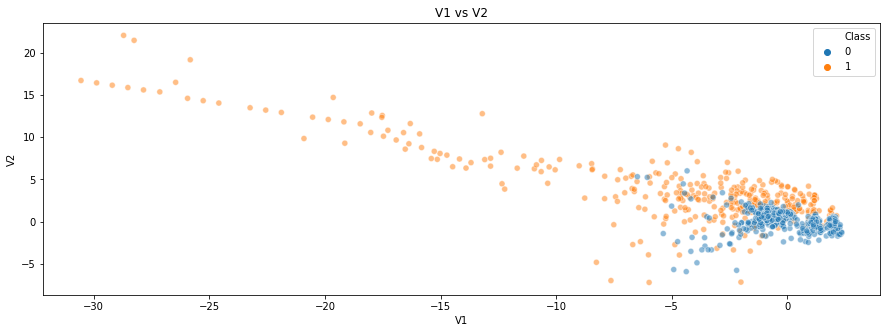

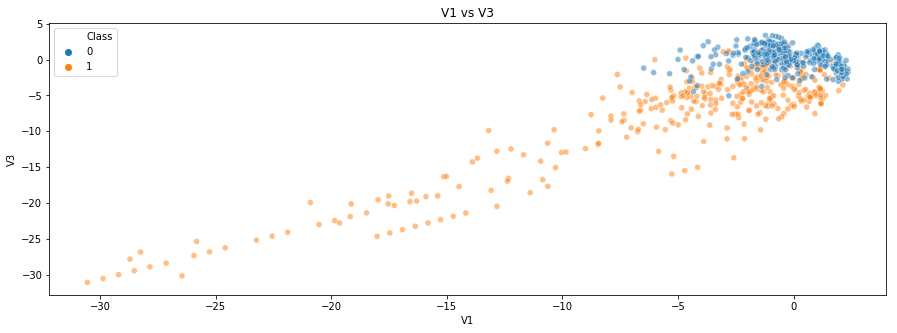

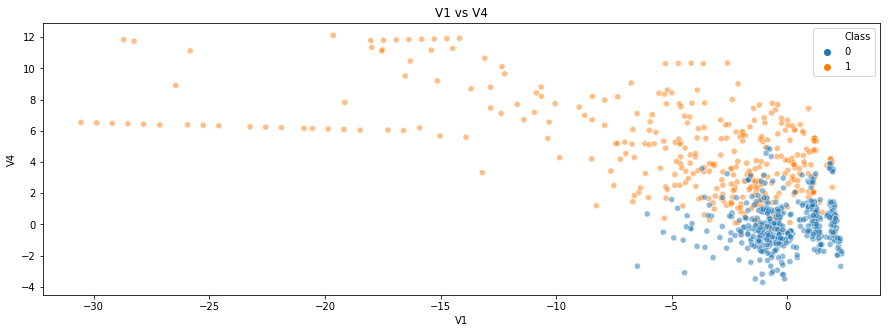

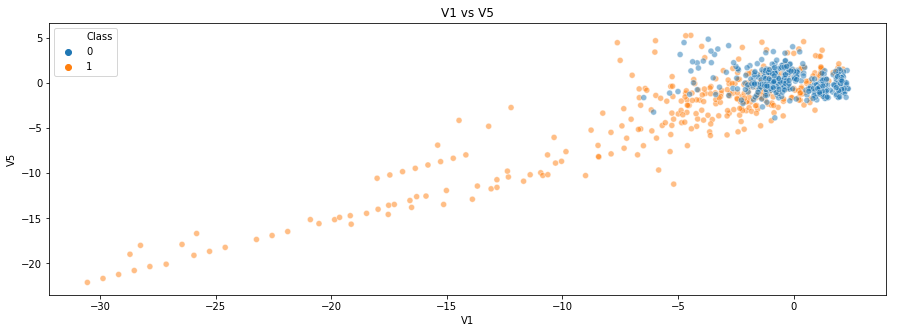

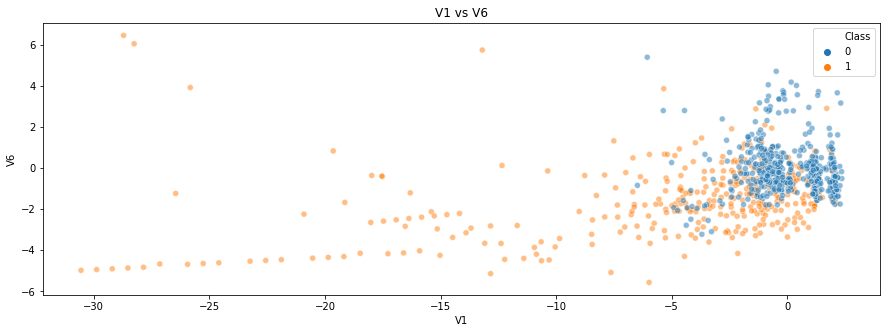

...

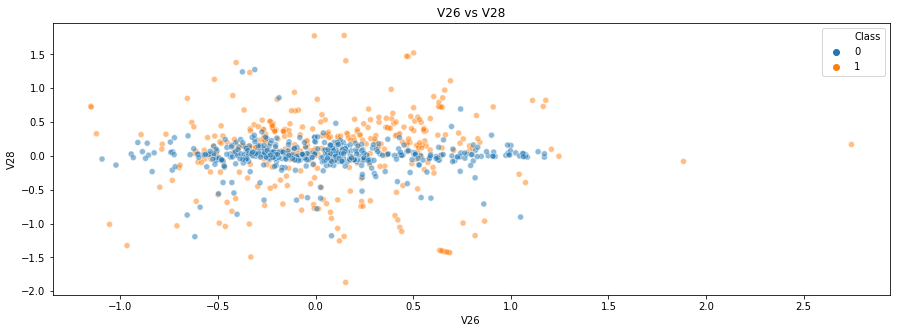

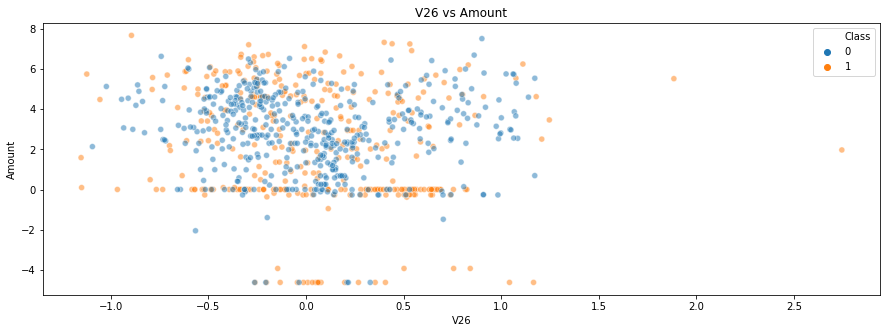

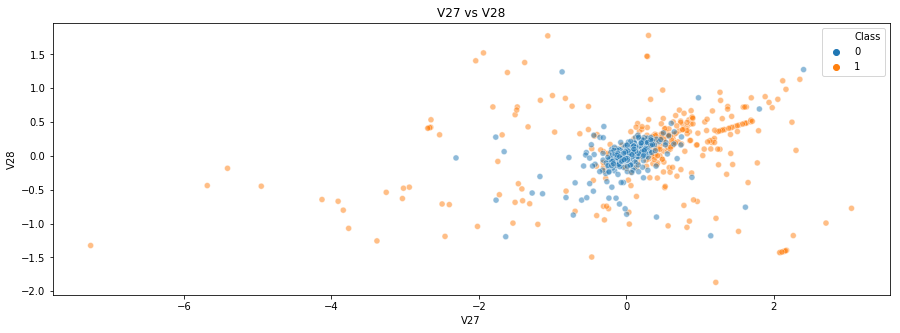

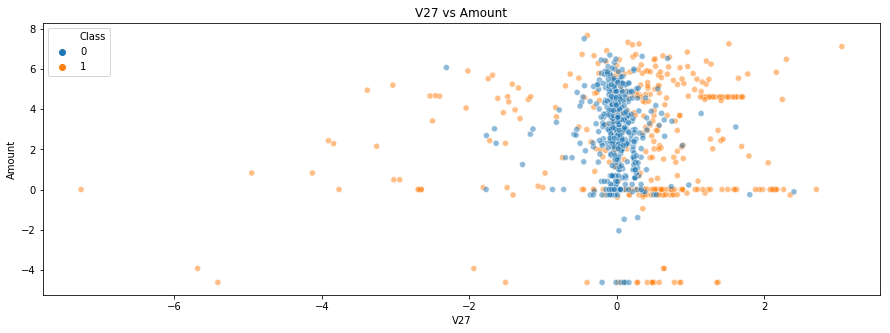

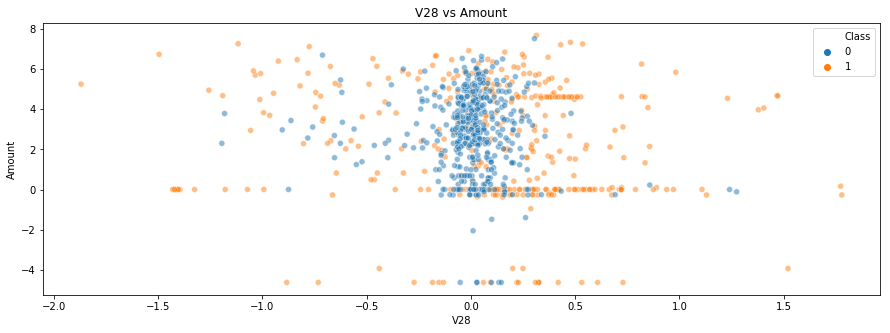

In [38]:
# plot variables against one another with scatter plots and 
# distinguish class using color

# record a list of columns already plotted
already_plotted = []

# iterate over columns in balanced dataframe
for col1 in balanced_df.columns:
    
    # iterate over every column again, to get all combinations
    for col2 in balanced_df.columns:
        
        # make sure the pair hasnt already been plotted
        if (col1 + col2 not in already_plotted) & (col2 + col1 not in already_plotted):
            
            # make sure neither column is "Class"
            if (col1 != "Class") & (col2 != "Class"):
                
                # make sure a column isn't being plotted against itself
                if col1 != col2:
                
                    # add pair to already_plotted
                    already_plotted.append(col1 + col2)
                
                    # make the plot
                    plt.figure(figsize=(15, 5))
                    sns.scatterplot(balanced_df[col1], balanced_df[col2], hue=balanced_df.Class, alpha=0.5)
                    plt.title(col1 + " vs " + col2)
                    plt.legend()
                    plt.show()
    

After briefly analyzing each plot, I can conclude there are no hidden relationships between pairs of variables and the class. This leads me to suspect that linear machine learning algorithms may do the best job. Some variables have linear relationships to one another, which may cause a problem (multicolinearity).

# 4. Questions

It is difficult to use domain knoledge to ask questions because the majority of the variables have been anonymized. Regardless I have one meaningful question to test.

##### Question:  Is there a statistically significant difference in the amount of a transaction betweem fraud and non-fraud transactions?

To answer this question I will have the data split into two sets, fraud and non-fraud. Then I will use a Levene test to see if the two sets of data have similar variances. I will do this to let me choose the type of T-test to use to answer the question. If the variances are equal I will use a Student's T-test, otherwise I will use a Welch's T-test. The T-test uses the means and variances of two sets of data to calculate the probability they come from different populations (groups). To use the Levene test I first need to state what is none as the null and alternative hypotheses. The null hypothesis is that there is no statistically significant difference between the variances of the two groups. The alternative hypothesis is that there is a statistically significant difference between the two groups. The alpha value for the Levene test will be 0.05 as is commonly used in data science. The Leven test will return what is known as a P-value. If this value is higher than the alpha value I must reject the null hypothesis.

In [41]:
# seperate fraud and nonfraud
fraud = train[train["Class"] == 1]
nonfraud = train[train["Class"] == 0]

# Levene test the Amount columns of each set
levene(fraud.Amount, nonfraud.Amount)

LeveneResult(statistic=226.4467915425928, pvalue=3.758306590253525e-51)

The P-value is below the alpha value of 0.05, so I must not reject the null hypothesis. This means the variances are equal, therefor the best T-test to use is the Student's T-test. For the student T-test the null hypothesis is that there is no statistically significant difference between the two samples. The alternative hypothesis is that there is a statistically significant difference between the two samples. The alpha value again will be the standard 0.05. If the P-value returned from this test I must reject the null hypothesis, otherwise I must accept it.

In [42]:
ttest_ind(fraud.Amount, nonfraud.Amount)

Ttest_indResult(statistic=-6.630774926245164, pvalue=3.346728458283024e-11)

The P-value Is below the alpha value of 0.05, meaning I must accept the null hypothesis. So there is no statistically significant difference for the amount in a transaction between fraud and non-fraud transactions.

##### Anwer: No there is no statistically significant difference for the amount of the transaction between fraud and non-fraud samples.